<a href="https://colab.research.google.com/github/Vasu-srm/video-captioning-major-project/blob/main/VIDEO_CAPTIONING.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

📁 Please upload your GIF file...


Saving J_evFB7RIKA_104_120.gif to J_evFB7RIKA_104_120.gif
✅ File uploaded: J_evFB7RIKA_104_120.gif

🖼️ Displaying uploaded GIF:


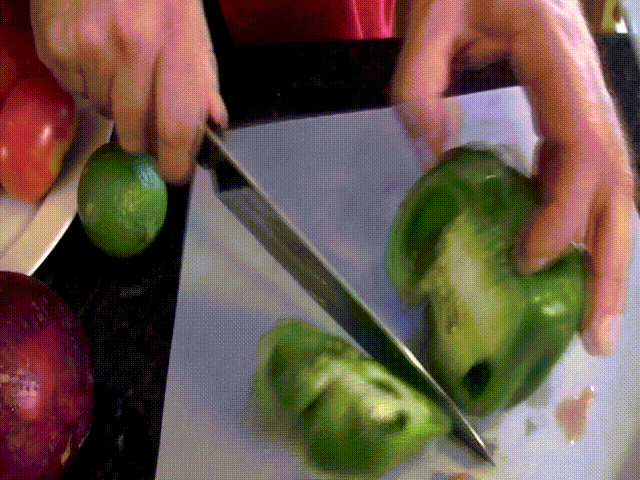


🔄 Loading LSTM model...

📝 Caption: "a person cutting a bell pepper on a cutting board"


In [ ]:
# @title
import torch
from PIL import Image, ImageSequence
from transformers import BlipProcessor, BlipForConditionalGeneration
from google.colab import files
from IPython.display import Image as IPyImage, display


print("📁 Please upload your file...")
uploaded = files.upload()
gif_path = list(uploaded.keys())[0]
print(f"✅ File uploaded: {gif_path}")


print("\n🖼️ Displaying uploaded Video:")
display(IPyImage(filename=gif_path))


print("\n🔄 Loading LSTM model...")
processor = BlipProcessor.from_pretrained("Salesforce/blip-image-captioning-base")
model = BlipForConditionalGeneration.from_pretrained("Salesforce/blip-image-captioning-base").eval()


gif = Image.open(gif_path)


frames = [frame.copy().convert("RGB") for frame in ImageSequence.Iterator(gif)]
middle_index = len(frames) // 2
middle_frame = frames[middle_index]


inputs = processor(images=middle_frame, return_tensors="pt")

with torch.no_grad():
    output = model.generate(**inputs)

    caption = processor.decode(output[0], skip_special_tokens=True)


    print(f"\n📝 Caption: \"{caption}\"")
